## Four coil optimization

Sweep four coil function

In [4]:
from maggeometry import four_coils
magnets = four_coils(1.09, 1, 2, 1, 1, 5, 5, True)

## Nelder-Mead optimization for four coils #1

In [10]:
from maggeometry import four_coils
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from scipy.optimize import minimize, Bounds
# innerrad1, innerrad2, width, thickness, dist1, dist2
# x0 = [133.416, 33.354, 5, 2.4, 200.124, 266.832]

Br = 1.09
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
def max_nonuniformity(x):
    innerrad1, innerrad2, width, thickness, dist1, dist2 = x
    magnets = four_coils(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_abs_nonuniformity

# innerrad1, innerrad2, width, thickness, dist1, dist2
bounds = Bounds([1, 1, 2, 2, 1, 1], [150, 150, 10, 20, 300, 300])
x0 = [133.416, 33.354, 5, 2.4, 200.124, 266.832]
# options = {'disp':True, 'fatol': 1e-14
options = {'disp':True}
method = "Nelder-Mead"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000003
         Iterations: 690
         Function evaluations: 1103
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 3.442418439405942e-06
             x: [ 1.444e+02  4.012e+01  8.356e+00  2.000e+01  2.173e+02
                  2.918e+02]
           nit: 690
          nfev: 1103
 final_simplex: (array([[ 1.444e+02,  4.012e+01, ...,  2.173e+02,
                         2.918e+02],
                       [ 1.444e+02,  4.012e+01, ...,  2.173e+02,
                         2.918e+02],
                       ...,
                       [ 1.444e+02,  4.012e+01, ...,  2.173e+02,
                         2.918e+02],
                       [ 1.444e+02,  4.012e+01, ...,  2.173e+02,
                         2.918e+02]]), array([ 3.442e-06,  3.442e-06,  3.442e-06,  3.442e-06,
                        3.442e-06,  3.442e-06,  3.442e-06]))


Maximum B-field along +z direction: 0.056 G
Central B-field along +z axis: 0.022 G
Maximum B-field along +x direction: 0.022 G
Central B-field along +x axis: 0.022 G
Min transverse nonuniformity: 0.0
Max transverse nonuniformity:3.4423505337963663e-06
Min axial nonuniformity: 0.0
Max axial nonuniformity:2.9866517340785132e-05


/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:165: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.

/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:182: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.



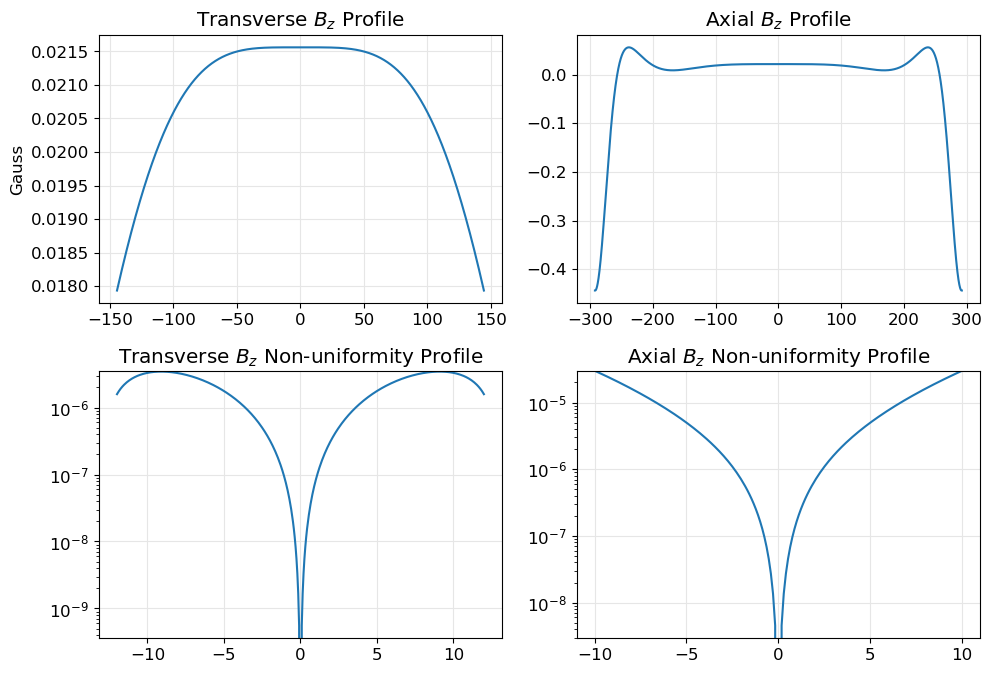

In [13]:
innerrad1, innerrad2, width, thickness, dist1, dist2 = res.x
magnets = four_coils(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
magpy.show(magnets, backend='plotly')
get_field_on_axes(magnets, dist2*2, innerrad1*2, [-12,12], [-10,10], is_logscale=True)

In [15]:
bounds = Bounds([10, 10, 2, 2, 1, 1], [150, 150, 10, 20, 250, 270])
x0 = [133.416, 33.354, 5, 2.4, 200.124, 266.832]
# options = {'disp':True, 'fatol': 1e-14
options = {'disp':True}
method = "Nelder-Mead"
res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000003
         Iterations: 668
         Function evaluations: 1076
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 2.552162216680583e-06
             x: [ 1.465e+02  1.732e+01  1.000e+01  9.057e+00  2.115e+02
                  2.438e+02]
           nit: 668
          nfev: 1076
 final_simplex: (array([[ 1.465e+02,  1.732e+01, ...,  2.115e+02,
                         2.438e+02],
                       [ 1.465e+02,  1.732e+01, ...,  2.115e+02,
                         2.438e+02],
                       ...,
                       [ 1.465e+02,  1.732e+01, ...,  2.115e+02,
                         2.438e+02],
                       [ 1.465e+02,  1.732e+01, ...,  2.115e+02,
                         2.438e+02]]), array([ 2.552e-06,  2.552e-06,  2.552e-06,  2.552e-06,
                        2.552e-06,  2.552e-06,  2.552e-06]))


Maximum B-field along +z direction: 0.177 G
Central B-field along +z axis: 0.011 G
Maximum B-field along +x direction: 0.011 G
Central B-field along +x axis: 0.011 G
Min transverse nonuniformity: 0.0
Max transverse nonuniformity:2.55210178213035e-06
Min axial nonuniformity: 0.0
Max axial nonuniformity:2.214761502155732e-05


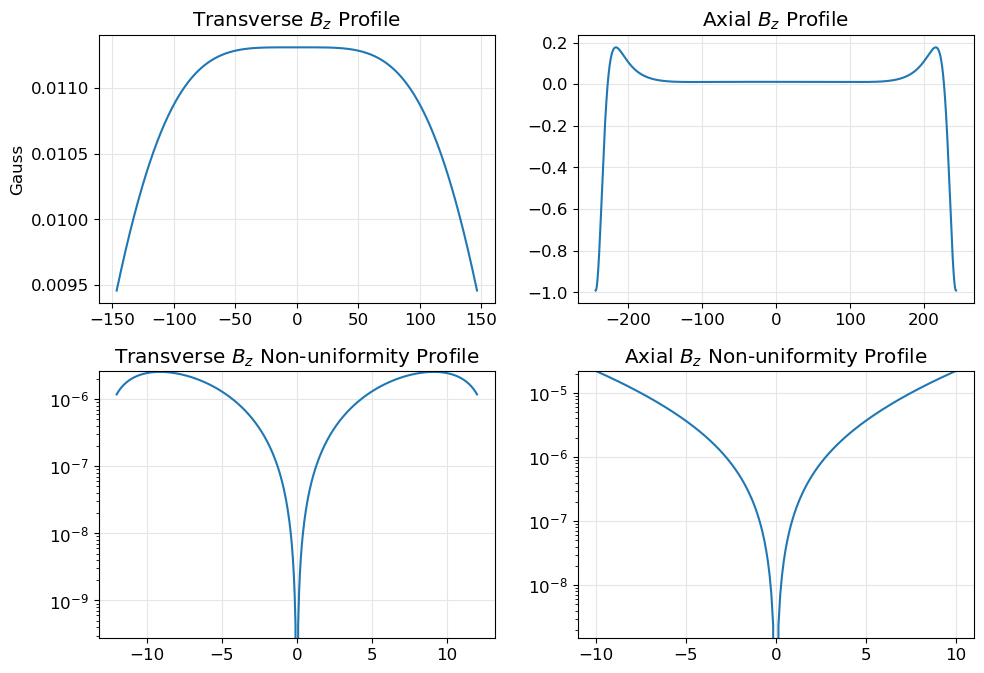

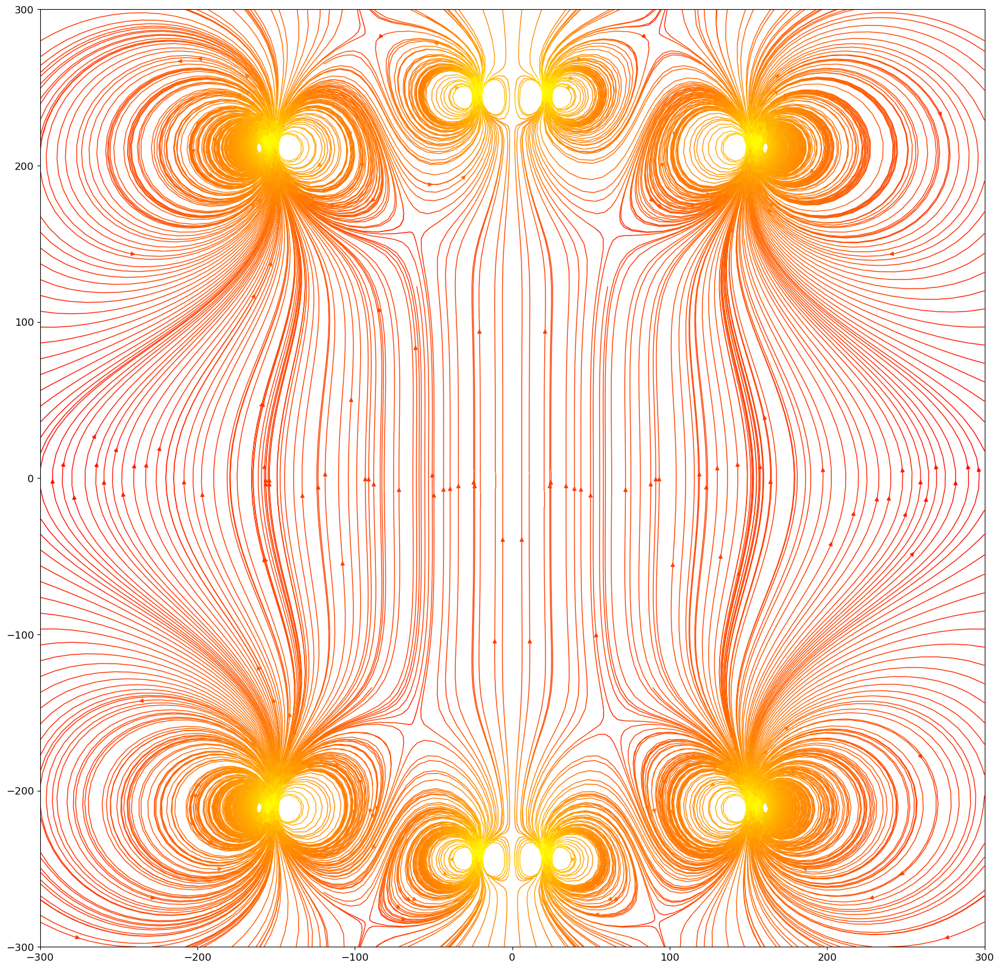

In [17]:
innerrad1, innerrad2, width, thickness, dist1, dist2 = res.x
magnets = four_coils(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
magpy.show(magnets, backend='plotly')
get_field_on_axes(magnets, dist2*2, innerrad1*2, [-12,12], [-10,10], is_logscale=True)

x_bounds = [-300, 300]
z_bounds = [-300, 300]
outerrad1 = innerrad1 + width
make_flux_stream(magnets, x_bounds, z_bounds, [])

In [20]:
# define FOM as nonuniformity * 1/center_field as we want to minimize nonuniformity and maximize center field
def max_fom(x):
    innerrad1, innerrad2, width, thickness, dist1, dist2 = x
    magnets = four_coils(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_abs_nonuniformity * 1/center_field
bounds = Bounds([10, 10, 2, 2, 1, 1], [150, 150, 10, 20, 220, 250])
# c_d, c_h, D
x0 = [60, 33, 5, 2.4, 40, 80]
# options = {'disp':True, 'fatol': 1e-14
options = {'disp':True}
method = "Nelder-Mead"
res = minimize(max_fom, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.007781
         Iterations: 701
         Function evaluations: 1113
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 0.007780673897431684
             x: [ 4.492e+01  2.918e+01  1.000e+01  2.693e+00  7.165e+01
                  9.785e+01]
           nit: 701
          nfev: 1113
 final_simplex: (array([[ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01],
                       [ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01],
                       ...,
                       [ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01],
                       [ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01]]), array([ 7.781e-03,  7.781e-03,  7.781e-03,  7.781e-03,
                        7.781e-03,  7.781e-03,  7.781e-03]))


Maximum B-field along +z direction: 0.037 G
Central B-field along +z axis: 0.037 G
Maximum B-field along +x direction: 0.037 G
Central B-field along +x axis: 0.037 G
Min transverse nonuniformity: 0.0
Max transverse nonuniformity:0.0002910363130450056
Min axial nonuniformity: 0.0
Max axial nonuniformity:0.0025626932580090005


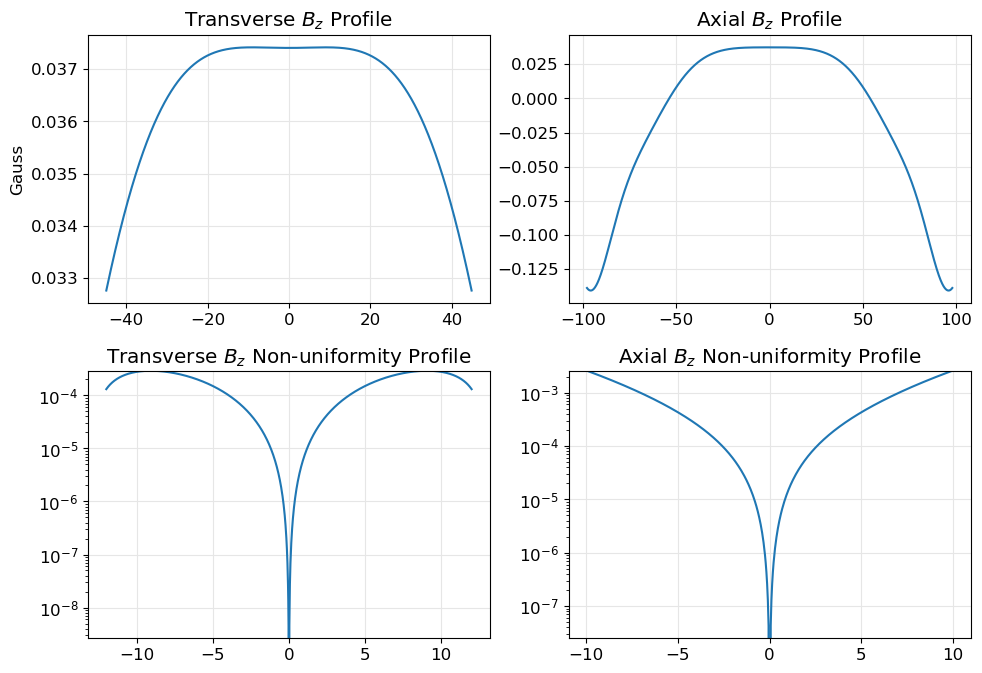

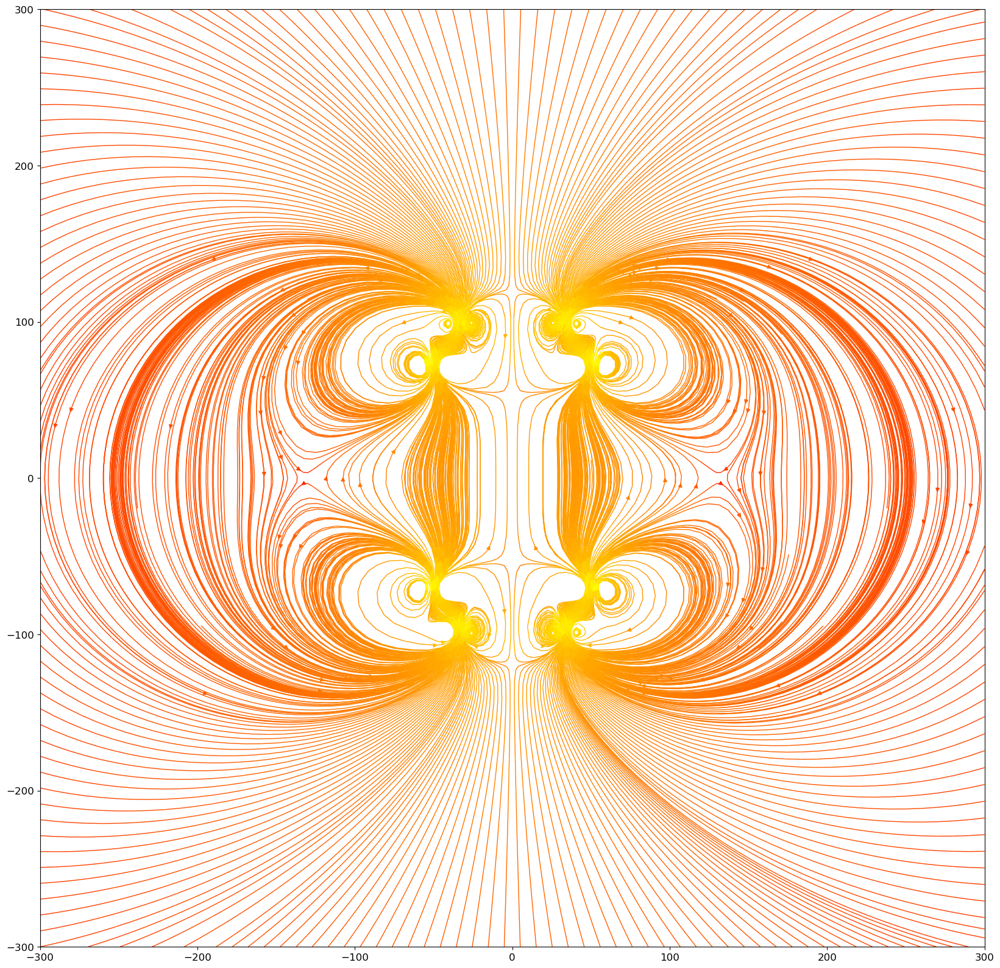

In [21]:
innerrad1, innerrad2, width, thickness, dist1, dist2 = res.x
magnets = four_coils(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
magpy.show(magnets, backend='plotly')
get_field_on_axes(magnets, dist2*2, innerrad1*2, [-12,12], [-10,10], is_logscale=True)

x_bounds = [-300, 300]
z_bounds = [-300, 300]
outerrad1 = innerrad1 + width
make_flux_stream(magnets, x_bounds, z_bounds, [])

In [22]:
method = "Powell"
res = minimize(max_fom, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000806
         Iterations: 10
         Function evaluations: 1706
 message: Optimization terminated successfully.
 success: True
  status: 0
     fun: 0.000806052841564818
       x: [ 8.179e+01  6.294e+01  5.000e+00  1.999e+01  1.315e+02
            2.065e+02]
     nit: 10
   direc: [[-6.475e-02 -8.438e-02 ...  5.263e-02 -2.816e-04]
           [ 0.000e+00  1.000e+00 ...  0.000e+00  0.000e+00]
           ...
           [ 0.000e+00  0.000e+00 ...  1.000e+00  0.000e+00]
           [-6.791e-05 -3.854e-04 ... -2.789e-07 -1.880e-06]]
    nfev: 1706


Maximum B-field along +z direction: 0.039 G
Central B-field along +z axis: 0.039 G
Maximum B-field along +x direction: 0.039 G
Central B-field along +x axis: 0.039 G
Min transverse nonuniformity: 0.0
Max transverse nonuniformity:3.162684253249945e-05
Min axial nonuniformity: 0.0
Max axial nonuniformity:0.00027439676455034897


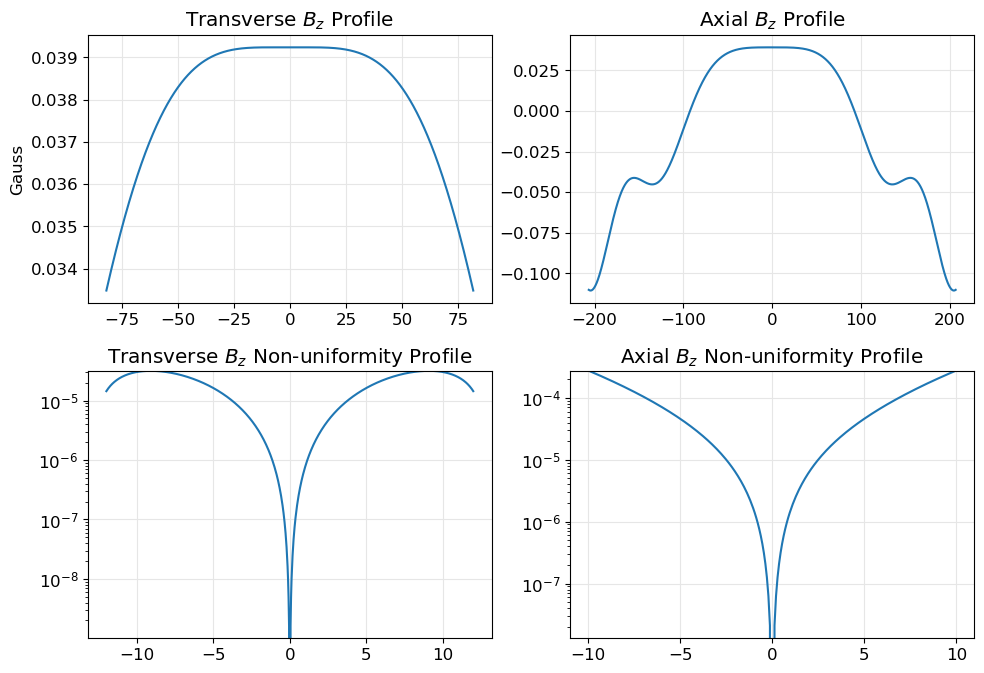

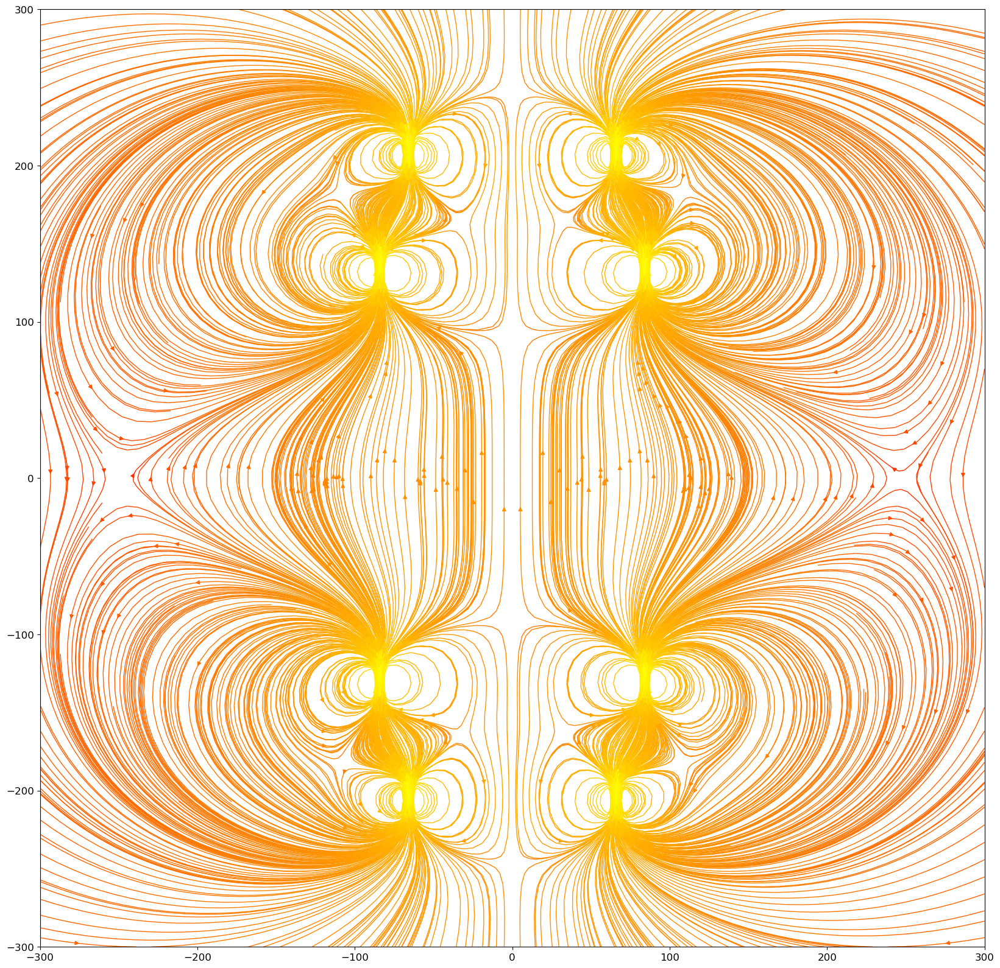

In [23]:
innerrad1, innerrad2, width, thickness, dist1, dist2 = res.x
magnets = four_coils(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
magpy.show(magnets, backend='plotly')
get_field_on_axes(magnets, dist2*2, innerrad1*2, [-12,12], [-10,10], is_logscale=True)

x_bounds = [-300, 300]
z_bounds = [-300, 300]
outerrad1 = innerrad1 + width
make_flux_stream(magnets, x_bounds, z_bounds, [])

In [24]:
# define FOM as nonuniformity * 1/center_field as we want to minimize nonuniformity and maximize center field
def max_fom(x):
    innerrad1, innerrad2, width, thickness, dist1, dist2 = x
    magnets = four_coils(Br, innerrad1, innerrad2, width, thickness, dist1, dist2)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_abs_nonuniformity * 1/center_field
bounds = Bounds([10, 10, 2, 2, 1, 1], [150, 150, 10, 20, 110, 110])
# c_d, c_h, D
x0 = [60, 33, 5, 2.4, 40, 80]
# options = {'disp':True, 'fatol': 1e-14
options = {'disp':True}
method = "Nelder-Mead"
res = minimize(max_fom, x0, method=method, options=options, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.007781
         Iterations: 701
         Function evaluations: 1113
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 0.007780673897431684
             x: [ 4.492e+01  2.918e+01  1.000e+01  2.693e+00  7.165e+01
                  9.785e+01]
           nit: 701
          nfev: 1113
 final_simplex: (array([[ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01],
                       [ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01],
                       ...,
                       [ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01],
                       [ 4.492e+01,  2.918e+01, ...,  7.165e+01,
                         9.785e+01]]), array([ 7.781e-03,  7.781e-03,  7.781e-03,  7.781e-03,
                        7.781e-03,  7.781e-03,  7.781e-03]))
